In [1]:
!git clone https://github.com/facebookresearch/segment-anything-2.git

fatal: destination path 'segment-anything-2' already exists and is not an empty directory.


In [2]:
%cd segment-anything-2

/home/rozeqz/ML/SAM2-Labeling/segment-anything-2


/home/rozeqz/ML/SAM2-Labeling/venv/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [3]:
!pip install -e .
!pip install -e ".[demo]"

Obtaining file:///home/rozeqz/ML/SAM2-Labeling/segment-anything-2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for SAM-2 (pyproject.toml) ... done
  Created wheel for SAM-2: filename=SAM_2-1.0-0.editable-py3-none-any.whl size=12333 sha256=0e048fdd02da0e7d421b31e55447501f51f9ef493baafadcd10629600a8e4f5f
  Stored in directory: /tmp/pip-ephem-wheel-cache-9joqw78z/wheels/f0/57/f6/54583e1dce6b7f07ae03f7216e201cb6bae5bbeb863f027499
Successfully built SAM-2
  Attempting uninstall: SAM-2
    Found existing installation: SAM-2 1.0
    Uninstalling SAM-2-1.0:
      Successfully uninstalled SAM-2-1.0
Obtaining file:///home/rozeqz/ML/SAM2-Labeling/segment-anything-2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  

In [4]:
%cd checkpoints

/home/rozeqz/ML/SAM2-Labeling/segment-anything-2/checkpoints


In [5]:
!./download_ckpts.sh

--2024-09-23 17:53:50--  https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_tiny.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 

18.165.140.57, 18.165.140.3, 18.165.140.51, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|18.165.140.57|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 155906050 (149M) [application/vnd.snesdev-page-table]
Saving to: ‘sam2_hiera_tiny.pt’

sam2_hiera_tiny.pt  100%[===================>] 148.68M  23.2MB/s    in 6.0s    

2024-09-23 17:53:55 (24.7 MB/s) - ‘sam2_hiera_tiny.pt’ saved [155906050/155906050]

--2024-09-23 17:53:55--  https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_small.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 18.165.140.57, 18.165.140.3, 18.165.140.51, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|18.165.140.57|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 184309650 (176M) [application/vnd.snesdev-page-table]
Saving to: ‘sam2_hiera_small.pt’

sam2_hiera_small.pt 100%[===================>] 175.77M  22.2MB/s    in 7.6s    

2024-09-23 17:54:03 

In [116]:
import os
import cv2
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image

# use bfloat16 for the entire notebook
torch.autocast(device_type="cuda", dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

In [117]:
def show_anns(anns, borders=True):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:, :, 3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.5]])
        img[m] = color_mask
        if borders:
            contours, _ = cv2.findContours(m.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
            # Try to smooth contours
            contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
            cv2.drawContours(img, contours, -1, (0, 0, 1, 0.4), thickness=1)

    ax.imshow(img)

In [10]:
%cd ../..

/home/rozeqz/ML/SAM2-Labeling


/home/rozeqz/ML/SAM2-Labeling/venv/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


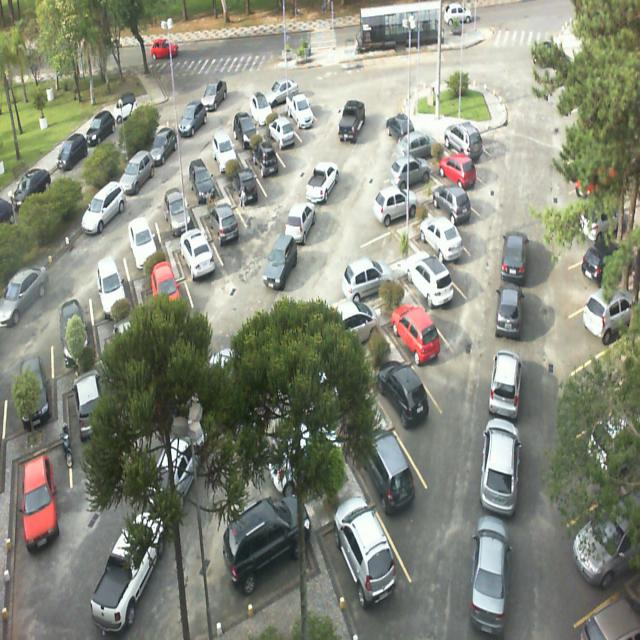

In [118]:
image = Image.open('images/2012-12-13_19_00_15_jpg.rf.3afef939e1eb7e0aa3359a5f9ee58e87.jpg')
image

In [119]:
image = np.array(image.convert("RGB"))

In [120]:
from sam2.build_sam import build_sam2
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator, SAM2ImagePredictor

sam2_checkpoint = "segment-anything-2/checkpoints/sam2_hiera_large.pt"
model_cfg = "sam2_hiera_l.yaml"

sam2 = build_sam2(model_cfg, sam2_checkpoint, device ='cuda', apply_postprocessing=False)

mask_generator = SAM2AutomaticMaskGenerator(sam2)

# mask_generator_2 = SAM2AutomaticMaskGenerator(
#     model=sam2,
#     points_per_side=64,
#     points_per_batch=128,
#     pred_iou_thresh=0.7,
#     stability_score_thresh=0.92,
#     stability_score_offset=0.7,
#     crop_n_layers=1,
#     box_nms_thresh=0.7,
#     crop_n_points_downscale_factor=2,
#     min_mask_region_area=25.0,
#     use_m2m=True,
# )

# Автомаскирование

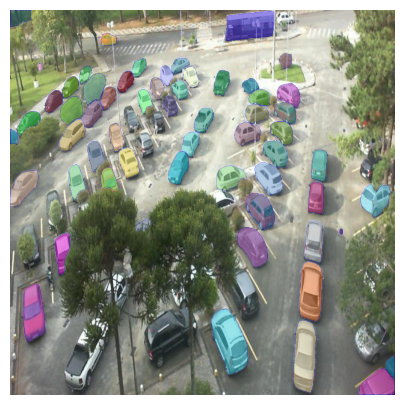

In [121]:
masks = mask_generator.generate(image)

plt.figure(figsize=(5,5))
plt.imshow(image)
plt.axis('off')

show_anns(masks)

plt.savefig('segmented/2012-12-13_19_00_15_jpg.rf.3afef939e1eb7e0aa3359a5f9ee58e87.jpg', bbox_inches='tight', pad_inches=0)
# plt.imsave('segmented/2012-12-13_19_00_15_jpg.rf.3afef939e1eb7e0aa3359a5f9ee58e87.jpg', image)

images/2013-04-09_10_40_05_jpg.rf.0eaa93f6db739b3f06efae932a434b2b.jpg
images/2012-12-13_19_00_15_jpg.rf.3afef939e1eb7e0aa3359a5f9ee58e87.jpg
images/2013-03-09_08_10_02_jpg.rf.84949294ca0782c3311375bd8c91b55f.jpg
images/2013-03-06_18_45_14_jpg.rf.5f626d6143cad716b6a47480cff18c8c.jpg
images/2012-12-18_12_50_08_jpg.rf.415ea6613015bcff8ecf55071eb19725.jpg
images/2012-12-22_18_35_15_jpg.rf.f037881f55602c69632a1010dec8a08e.jpg
images/2012-12-21_18_05_14_jpg.rf.d126f75199aa80b049f6e1ff2bc3bb3f.jpg
images/2012-12-19_16_05_12_jpg.rf.930380137af9b063b80df296fa850180.jpg
images/2013-03-05_09_45_04_jpg.rf.e8589d4a1ec587d59d96187a21b6568e.jpg
images/2012-12-21_16_00_11_jpg.rf.9bfe05c56d7aca447d248b68646af7a9.jpg
images/2013-03-17_11_55_06_jpg.rf.057c7173cf9c7802d634dfd11bd7a6f1.jpg


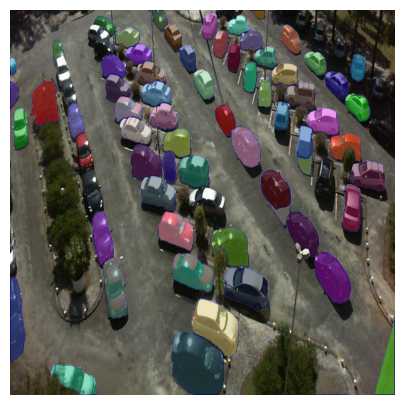

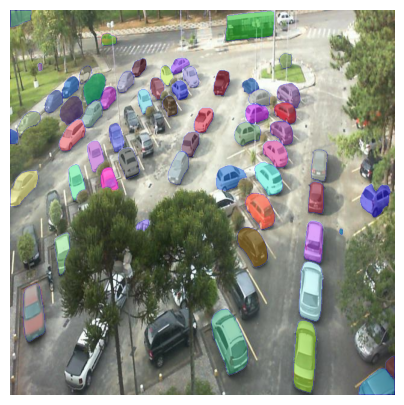

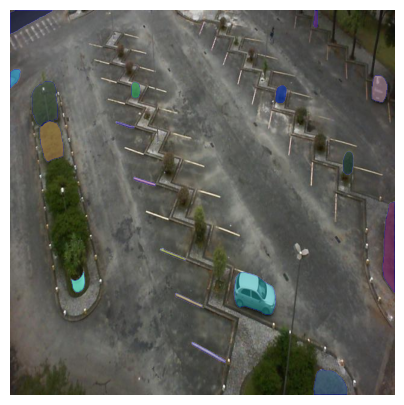

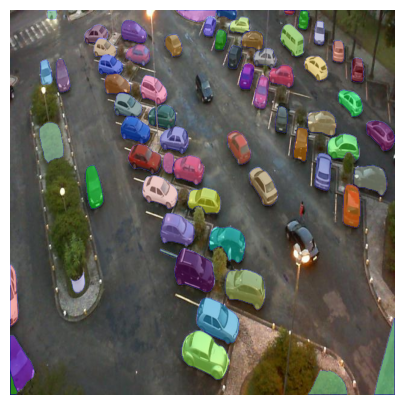

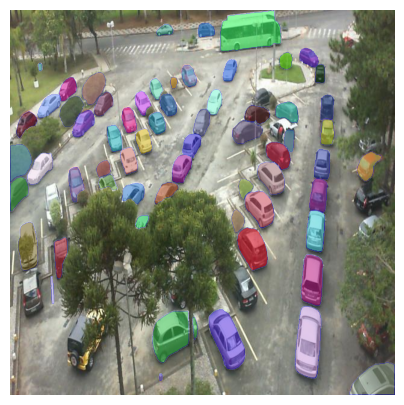

...

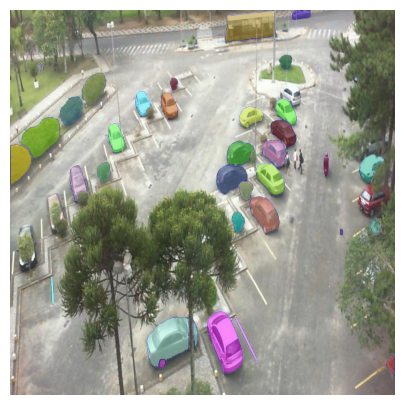

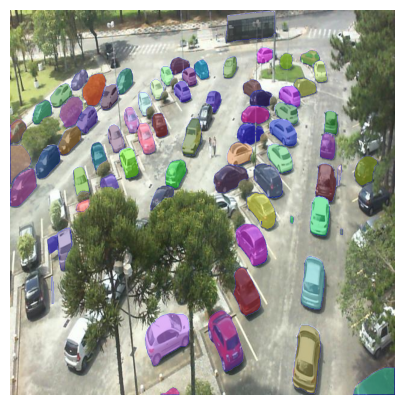

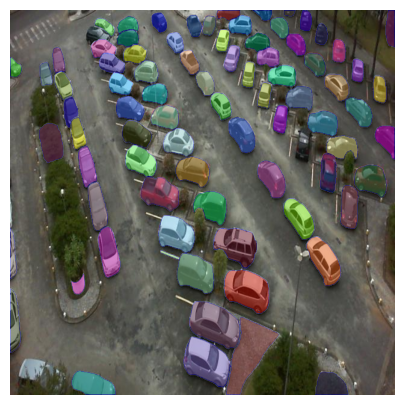

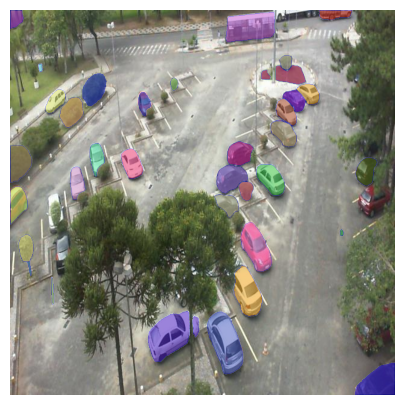

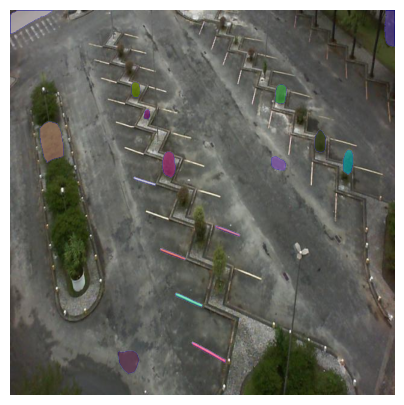

In [122]:
for img_name in os.listdir("images"):
  img_path = "images/" + img_name
  print(img_path)

  image = Image.open(img_path)
  image = np.array(image.convert("RGB"))

  masks = mask_generator.generate(image)

  plt.figure(figsize=(5,5))
  plt.imshow(image)
  plt.axis('off')

  show_anns(masks)

  plt.savefig('segmented/' + img_name, bbox_inches='tight', pad_inches=0)


# Маскирование с использованием bbox'ов

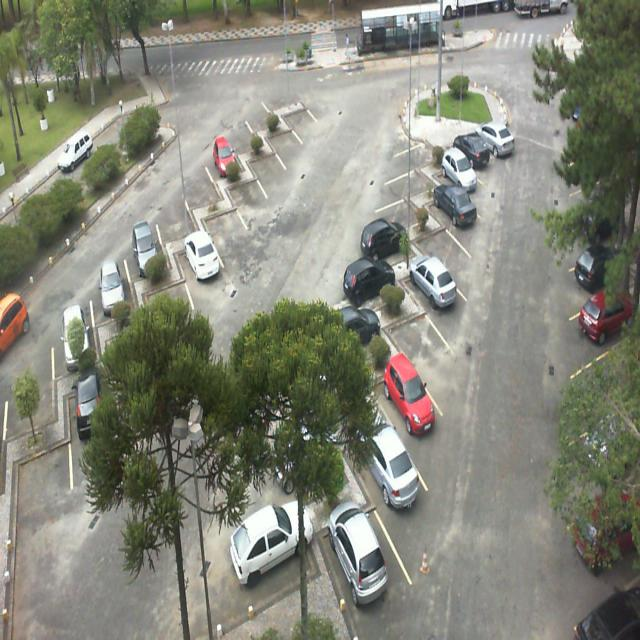

In [123]:
image = Image.open('images/2012-12-21_16_00_11_jpg.rf.9bfe05c56d7aca447d248b68646af7a9.jpg')
image

In [124]:
image = np.array(image.convert("RGB"))

In [125]:
predictor = SAM2ImagePredictor(sam2, mask_threshold=0.5)

In [126]:
predictor.set_image(image)

labels/2012-12-21_16_00_11_jpg.rf.9bfe05c56d7aca447d248b68646af7a9.txt


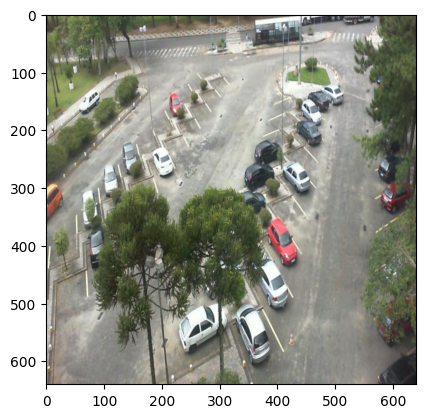

In [127]:
input_boxes = np.empty((0, 4))
i = -1

for label_name in os.listdir("labels"):
	i += 1
	if i != 0:
		continue
	label_path = "labels/" + label_name
	img_path = "images/" + label_name.replace('.txt', '.jpg')

	print(label_path)

	image = Image.open(img_path)
	image = np.array(image.convert("RGB"))
	height, width, _ = image.shape

	with open(label_path, 'r') as f:
			labels = f.read().strip().split('\n')

	for line in labels:
		parts = line.strip().split()

		class_id = int(parts[0])

		color = (255, 0, 0)

		if class_id == 1:
			color = (0, 255, 0)

		x_center = float(parts[1])
		y_center = float(parts[2])
		box_width = float(parts[3])
		box_height = float(parts[4])

		x1 = int((x_center - box_width / 2) * width)
		y1 = int((y_center - box_height / 2) * height)
		x2 = int((x_center + box_width / 2) * width)
		y2 = int((y_center + box_height / 2) * height)

		if class_id == 1:
			input_boxes = np.vstack([input_boxes, [x1, y1, x2, y2]])

		# cv2.rectangle(image, (x1, y1), (x2, y2), color=color, thickness=2)

	plt.imshow(image)
	plt.show()

	break

In [128]:
input_boxes

array([[321., 487., 402., 620.],
       [350., 401., 424., 521.],
       [373., 354., 439., 443.],
       [405., 250., 459., 327.],
       [425., 172., 478., 235.],
       [436., 147., 489., 200.],
       [448., 122., 491., 168.],
       [235., 500., 324., 608.],
       [339., 249., 398., 309.],
       [355., 215., 413., 265.],
       [180., 222., 219., 290.],
       [ 94., 244., 135., 323.],
       [126., 214., 167., 279.],
       [205., 124., 240., 178.]])

In [129]:
def show_mask(mask, ax, random_color=False, borders = True):
	if random_color:
		color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
	else:
		color = np.array([30/255, 144/255, 255/255, 0.6])
	h, w = mask.shape[-2:]
	mask = mask.astype(np.uint8)
	mask_image =  mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
	if borders:
		contours, _ = cv2.findContours(mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
		# Try to smooth contours
		contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
		mask_image = cv2.drawContours(mask_image, contours, -1, (1, 1, 1, 0.5), thickness=2)
	ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=100):
	pos_points = coords[labels==1]
	neg_points = coords[labels==0]
	ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
	ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
	x0, y0 = box[0], box[1]
	w, h = box[2] - box[0], box[3] - box[1]
	ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))

def show_masks(image, masks, scores, point_coords=None, box_coords=None, input_labels=None, borders=True):
	for i, (mask, score) in enumerate(zip(masks, scores)):
		plt.figure(figsize=(10, 10))
		plt.imshow(image)
		show_mask(mask, plt.gca(), borders=borders)
		if point_coords is not None:
			assert input_labels is not None
			show_points(point_coords, input_labels, plt.gca())
		if box_coords is not None:
			# boxes
			show_box(box_coords, plt.gca())
		if len(scores) > 1:
			plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
		plt.axis('off')
		plt.show()

In [130]:
masks, scores, _ = predictor.predict(
	point_coords=None,
	point_labels=None,
	box=input_boxes,
	multimask_output=False,
)

In [131]:
masks.shape

(14, 1, 640, 640)

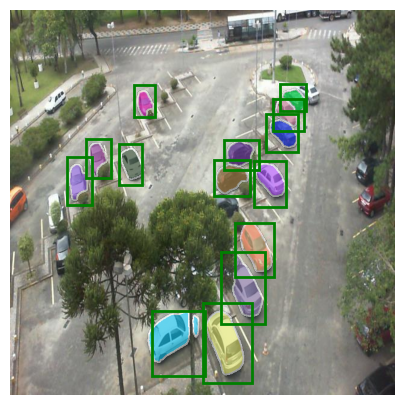

In [132]:
plt.figure(figsize=(5,5))
plt.imshow(image)
for mask in masks:
	show_mask(mask.squeeze(0), plt.gca(), random_color=True)
for box in input_boxes:
	show_box(box, plt.gca())
plt.axis('off')
plt.savefig('segmented_with_bboxes/' + '2012-12-21_16_00_11_jpg.rf.9bfe05c56d7aca447d248b68646af7a9.jpg', bbox_inches='tight', pad_inches=0)

## Сегментация внутри bbox'ов

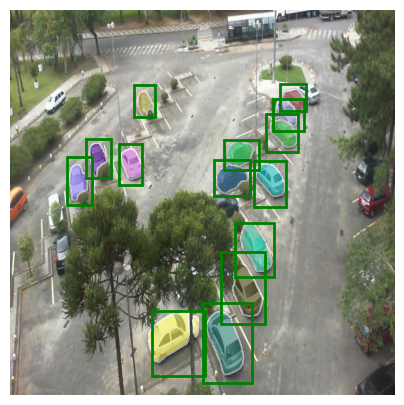

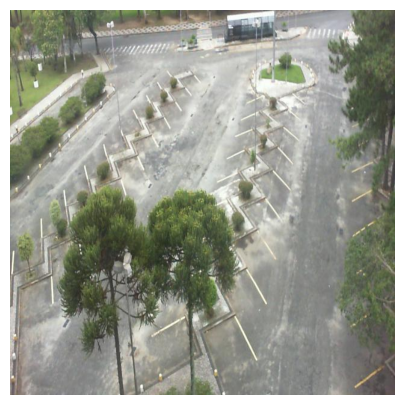

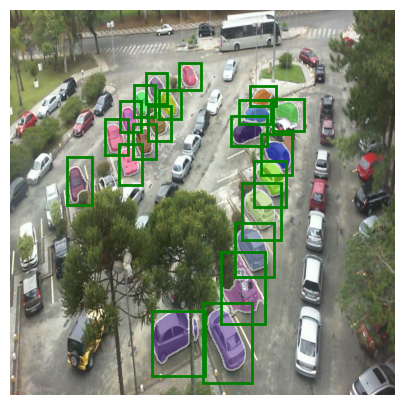

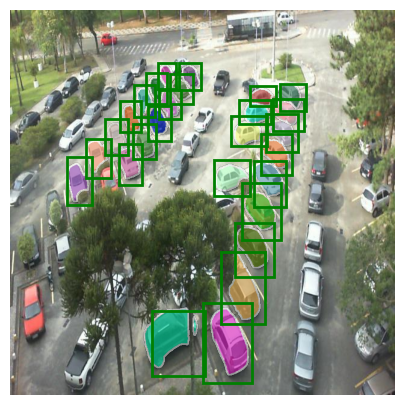

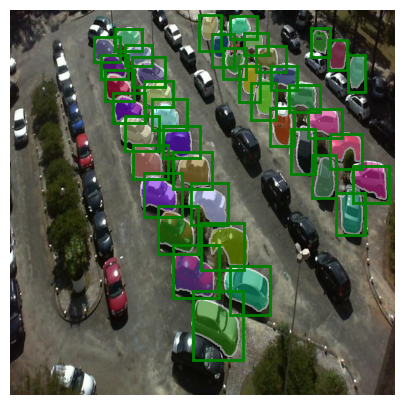

...

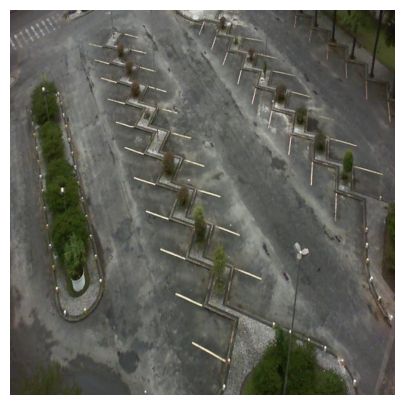

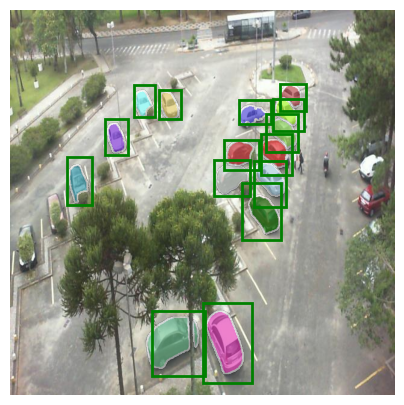

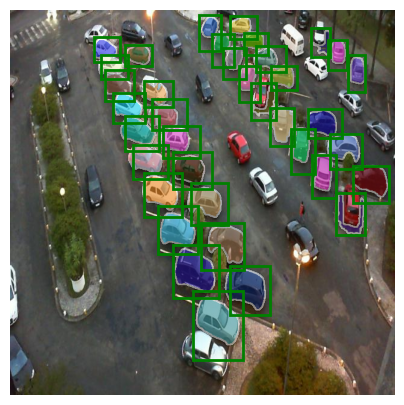

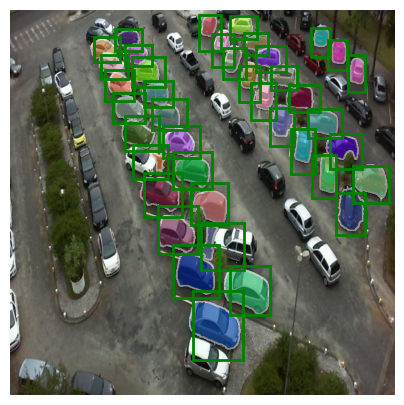

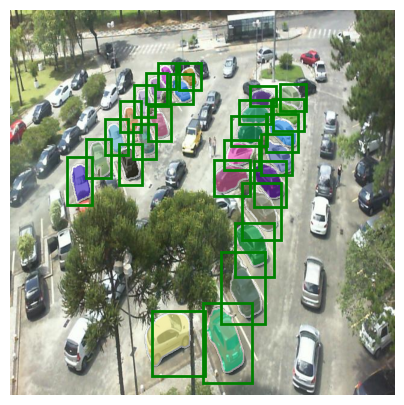

In [133]:
for label_name in os.listdir("labels"):
	label_path = "labels/" + label_name
	img_name = label_name.replace('.txt', '.jpg')
	img_path = "images/" + img_name

	image = Image.open(img_path)
	image = np.array(image.convert("RGB"))
	height, width, _ = image.shape

	predictor.set_image(image)

	input_boxes = np.empty((0, 4))

	with open(label_path, 'r') as f:
			labels = f.read().strip().split('\n')

	for line in labels:
		parts = line.strip().split()

		class_id = int(parts[0])

		color = (255, 0, 0)

		if class_id == 1:
			color = (0, 255, 0)

		x_center = float(parts[1])
		y_center = float(parts[2])
		box_width = float(parts[3])
		box_height = float(parts[4])

		x1 = int((x_center - box_width / 2) * width)
		y1 = int((y_center - box_height / 2) * height)
		x2 = int((x_center + box_width / 2) * width)
		y2 = int((y_center + box_height / 2) * height)

		if class_id == 1:
			input_boxes = np.vstack([input_boxes, [x1, y1, x2, y2]])

	plt.figure(figsize=(5,5))
	plt.imshow(image)
	if len(input_boxes) != 0:
		masks, scores, _ = predictor.predict(
			point_coords=None,
			point_labels=None,
			box=input_boxes,
			multimask_output=False,
		)

		try:
			for mask in masks:
				show_mask(mask.squeeze(0), plt.gca(), random_color=True)
			for box in input_boxes:
				show_box(box, plt.gca())
		except:
			pass
	plt.axis('off')
	plt.savefig('segmented_with_bboxes/' + img_name, bbox_inches='tight', pad_inches=0)

## Сегментация точками - центрами bbox'ов

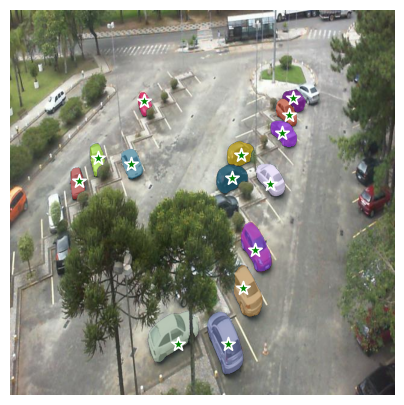

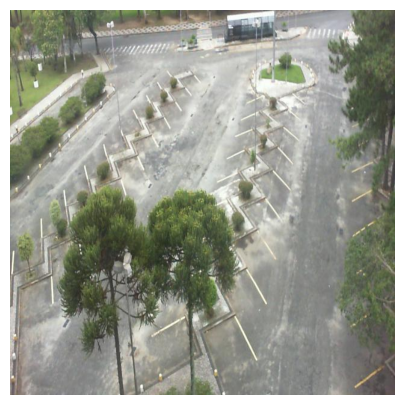

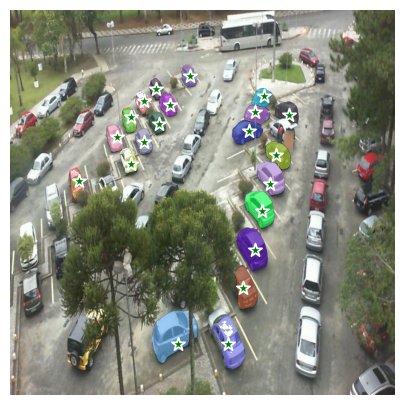

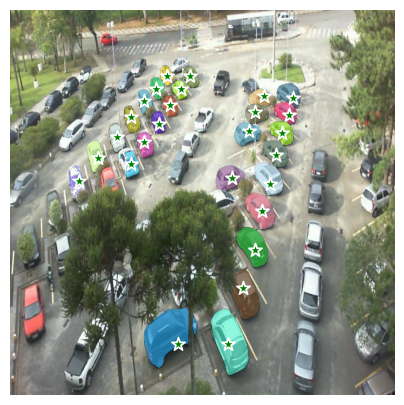

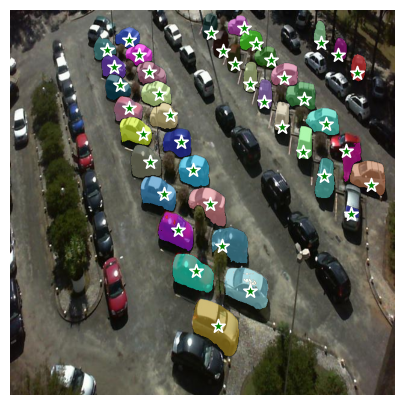

...

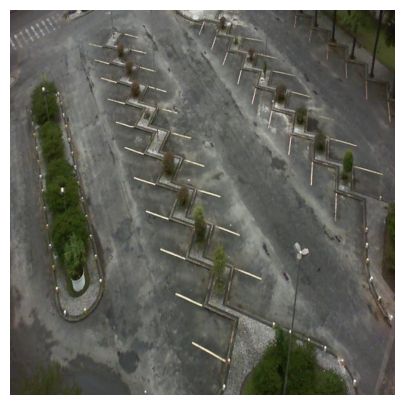

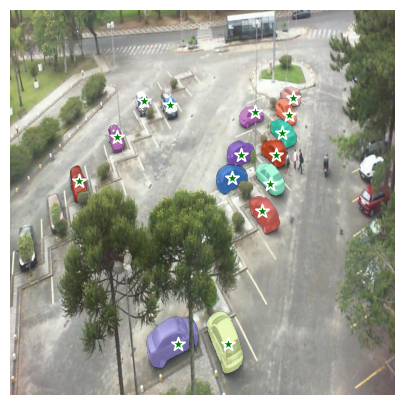

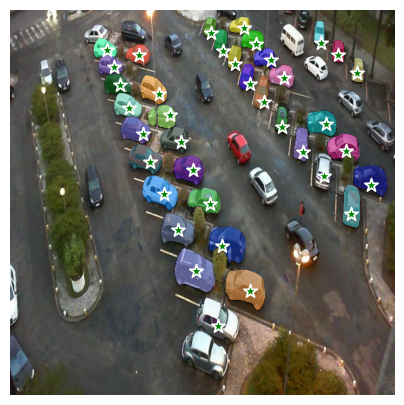

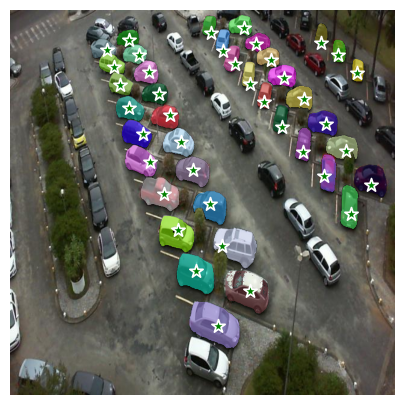

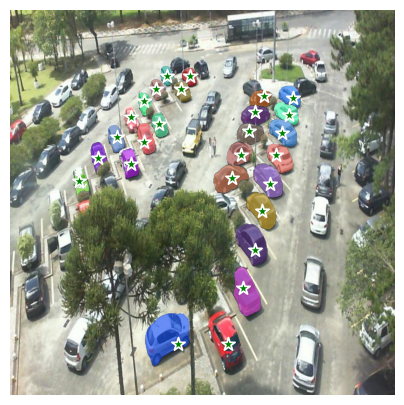

In [134]:
for label_name in os.listdir("labels"):
	label_path = "labels/" + label_name
	img_name = label_name.replace('.txt', '.jpg')
	img_path = "images/" + img_name

	image = Image.open(img_path)
	image = np.array(image.convert("RGB"))
	height, width, _ = image.shape

	predictor.set_image(image)

	# Bx1x2 where B corresponds to number of objects 
	input_points = np.empty((0, 1, 2))
	input_labels = np.empty((0, 1))

	with open(label_path, 'r') as f:
			labels = f.read().strip().split('\n')

	for line in labels:
		parts = line.strip().split()

		class_id = int(parts[0])

		if class_id == 1:
			x_center = float(parts[1])
			y_center = float(parts[2])
			box_width = float(parts[3])
			box_height = float(parts[4])

			# Координаты центра
			x_center_px = int(x_center * width)
			y_center_px = int(y_center * height)

			# Добавляем точку с дополнительным измерением (1, 1, 2)
			point = np.array([[[x_center_px, y_center_px]]])  # Создаем 3-мерный массив
			input_points = np.vstack([input_points, point])
			input_labels = np.vstack([input_labels, [[1]]])

	plt.figure(figsize=(5,5))
	plt.imshow(image)
	if len(input_points) != 0:
		masks, scores, logits = predictor.predict(
			point_coords=input_points,
			point_labels=input_labels,
			box=None,
			multimask_output=False,
		)
		for mask in masks:
			show_mask(mask, plt.gca(), random_color=True, borders=False)
		show_points(input_points, input_labels, plt.gca())
	plt.axis('off')
	plt.savefig('segmented_with_points/' + img_name, bbox_inches='tight', pad_inches=0)

## Сегментация внутри bbox'ов и их центрами

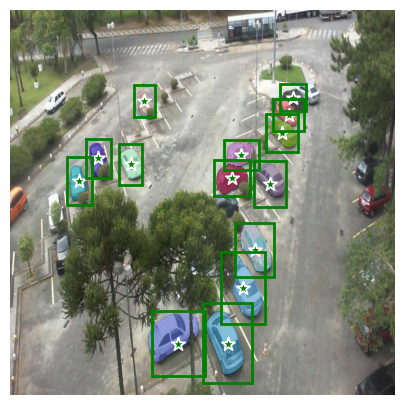

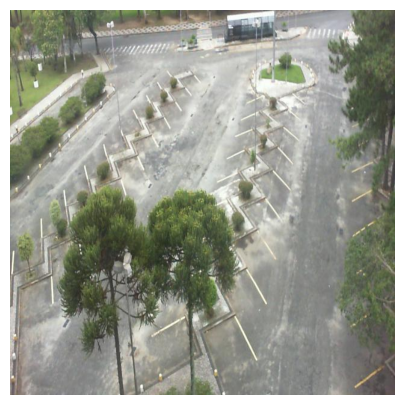

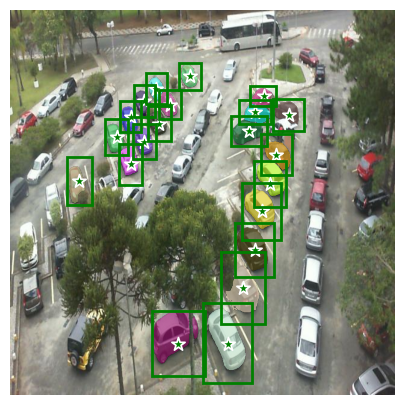

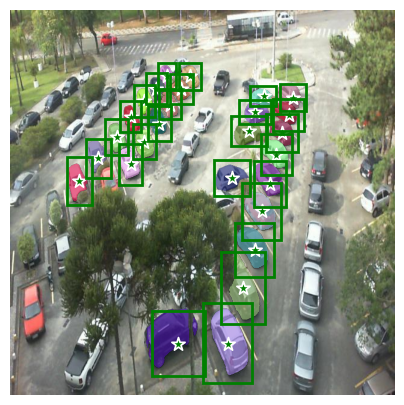

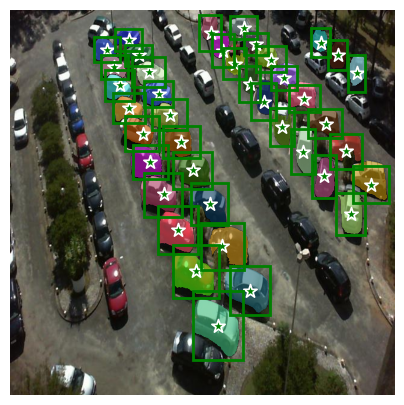

...

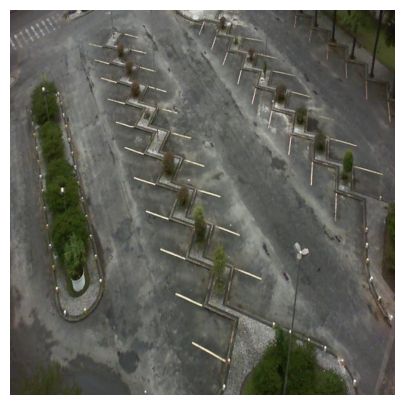

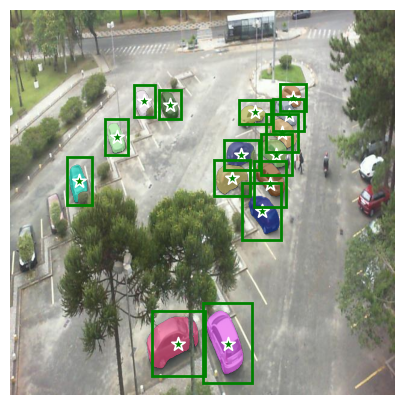

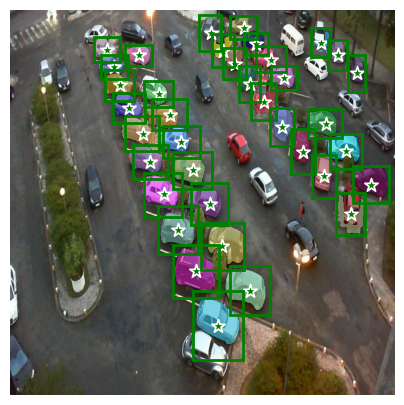

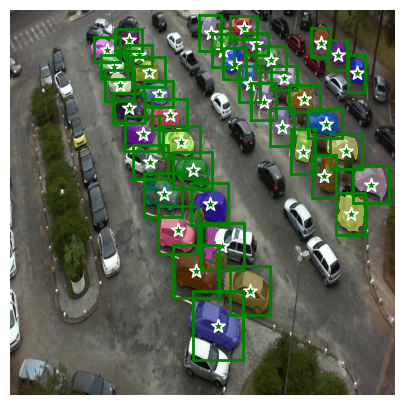

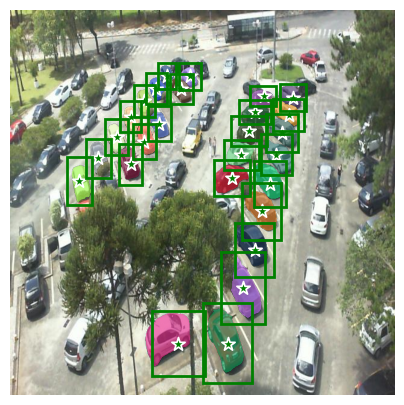

In [135]:
for label_name in os.listdir("labels"):
	label_path = "labels/" + label_name
	img_name = label_name.replace('.txt', '.jpg')
	img_path = "images/" + img_name

	image = Image.open(img_path)
	image = np.array(image.convert("RGB"))
	height, width, _ = image.shape

	predictor.set_image(image)

	# Bx1x2 where B corresponds to number of objects 
	input_points = np.empty((0, 1, 2))
	input_labels = np.empty((0, 1))
	input_boxes = np.empty((0, 4))

	with open(label_path, 'r') as f:
			labels = f.read().strip().split('\n')

	for line in labels:
		parts = line.strip().split()

		class_id = int(parts[0])

		if class_id == 1:
			x_center = float(parts[1])
			y_center = float(parts[2])
			box_width = float(parts[3])
			box_height = float(parts[4])

			# Координаты центра
			x_center_px = int(x_center * width)
			y_center_px = int(y_center * height)

			# Добавляем точку с дополнительным измерением (1, 1, 2)
			point = np.array([[[x_center_px, y_center_px]]])  # Создаем 3-мерный массив
			input_points = np.vstack([input_points, point])
			input_labels = np.vstack([input_labels, [[1]]])

			x1 = int((x_center - box_width / 2) * width)
			y1 = int((y_center - box_height / 2) * height)
			x2 = int((x_center + box_width / 2) * width)
			y2 = int((y_center + box_height / 2) * height)

			input_boxes = np.vstack([input_boxes, [x1, y1, x2, y2]])

	plt.figure(figsize=(5,5))
	plt.imshow(image)
	if len(input_points) != 0:
		masks, scores, logits = predictor.predict(
			point_coords=input_points,
			point_labels=input_labels,
			box=input_boxes,
			multimask_output=False,
		)
		for mask in masks:
			show_mask(mask, plt.gca(), random_color=True, borders=False)
		show_points(input_points, input_labels, plt.gca())
		for box in input_boxes:
				show_box(box, plt.gca())
	plt.axis('off')
	plt.savefig('segmented_with_both/' + img_name, bbox_inches='tight', pad_inches=0)

# Переразметка bbox'ов

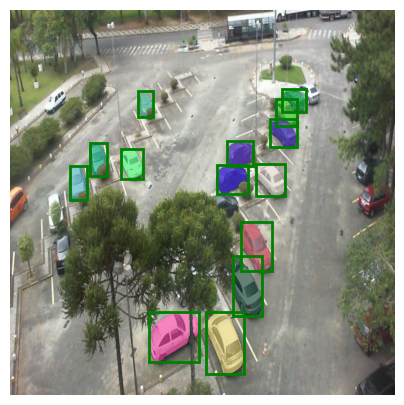

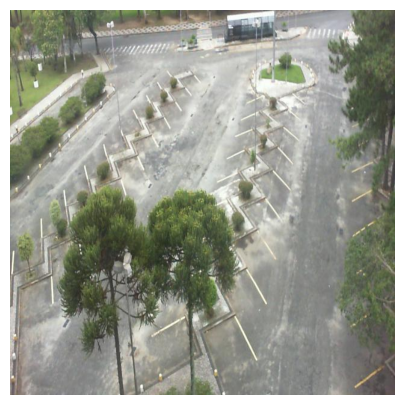

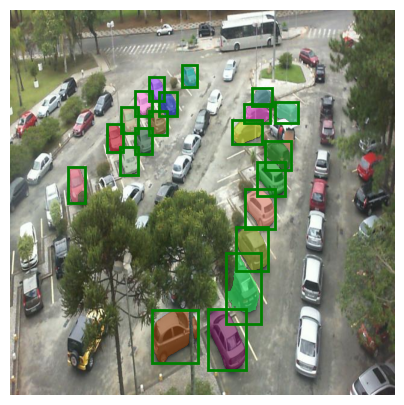

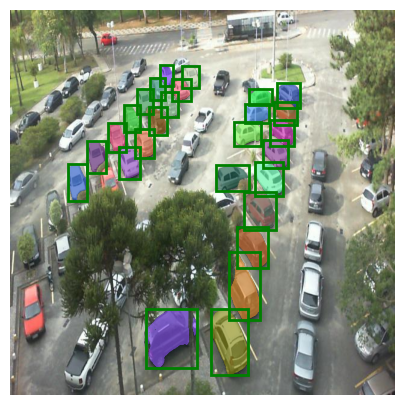

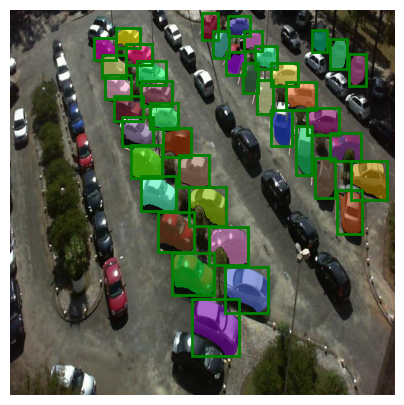

...

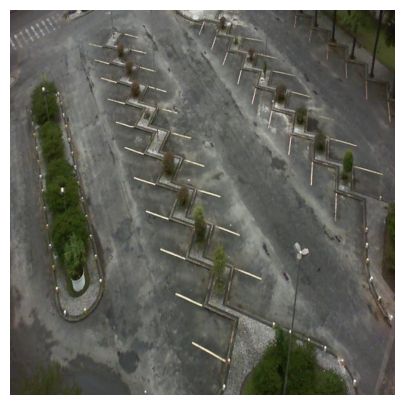

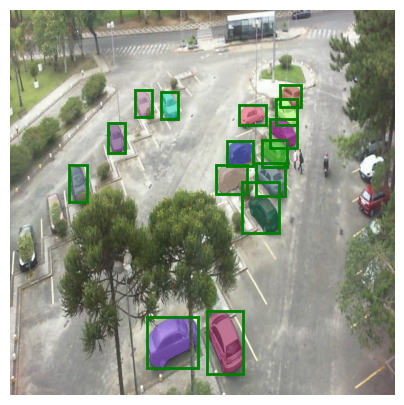

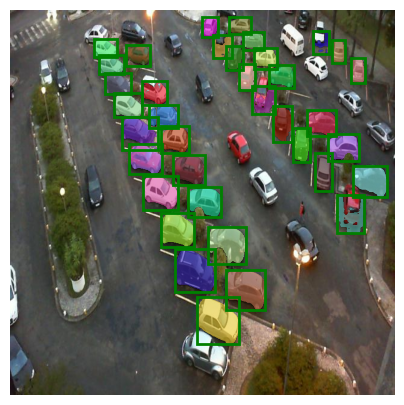

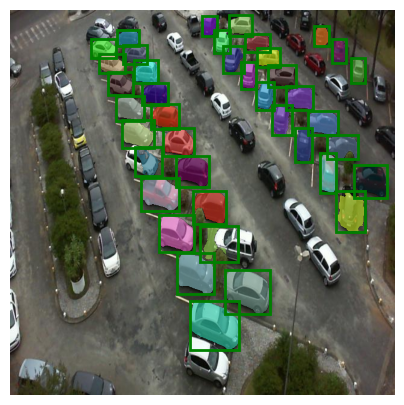

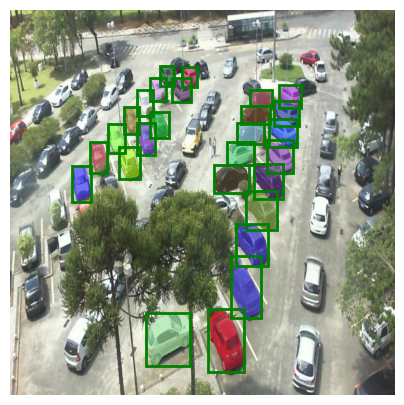

In [138]:
for label_name in os.listdir("labels"):
	labels = None

	label_path = "labels/" + label_name
	img_name = label_name.replace('.txt', '.jpg')
	img_path = "images/" + img_name

	image = Image.open(img_path)
	image = np.array(image.convert("RGB"))
	height, width, _ = image.shape

	predictor.set_image(image)

	# Bx1x2 where B corresponds to number of objects 
	input_points = np.empty((0, 1, 2))
	input_labels = np.empty((0, 1))
	input_boxes = np.empty((0, 4))

	with open(label_path, 'r') as f:
			labels = f.read().strip().split('\n')

	for line in labels:
		parts = line.strip().split()

		class_id = int(parts[0])

		if class_id == 1:
			x_center = float(parts[1])
			y_center = float(parts[2])
			box_width = float(parts[3])
			box_height = float(parts[4])

			# Координаты центра
			x_center_px = int(x_center * width)
			y_center_px = int(y_center * height)

			# Добавляем точку с дополнительным измерением (1, 1, 2)
			point = np.array([[[x_center_px, y_center_px]]])  # Создаем 3-мерный массив
			input_points = np.vstack([input_points, point])
			input_labels = np.vstack([input_labels, [[1]]])

			x1 = int((x_center - box_width / 2) * width)
			y1 = int((y_center - box_height / 2) * height)
			x2 = int((x_center + box_width / 2) * width)
			y2 = int((y_center + box_height / 2) * height)

			input_boxes = np.vstack([input_boxes, [x1, y1, x2, y2]])
	
	# Избавляемся от неправильной разметки
	new_labels = []
	for line in labels:
		if line[0] == '0':
			new_labels.append(line)

	plt.figure(figsize=(5,5))
	plt.imshow(image)
	if len(input_points) != 0:
		masks, scores, logits = predictor.predict(
			point_coords=input_points,
			point_labels=input_labels,
			box=input_boxes,
			multimask_output=False,
		)
		bounding_boxes = []
		for mask in masks:
			show_mask(mask, plt.gca(), random_color=True, borders=False)
			
			mask_indices = np.argwhere(mask)

			if len(mask_indices) > 0:
				try:
					_, y_min, x_min = mask_indices.min(axis=0)
					_, y_max, x_max = mask_indices.max(axis=0)
				except:
					y_min, x_min = mask_indices.min(axis=0)
					y_max, x_max = mask_indices.max(axis=0)

				box_width = float(x_max - x_min) / width
				box_height = float(y_max - y_min) / height
				x_center = float(x_max) / width - box_width / 2
				y_center = float(y_max) / height - box_height / 2

				new_labels.append(f"1 {x_center} {y_center} {box_width} {box_height}")

				bounding_boxes.append([x_min, y_min, x_max, y_max])
	
		for box in bounding_boxes:
				show_box(box, plt.gca())
		
	with open(label_path.replace("labels/", "new_labels/"), 'w') as f:
		for label in new_labels:
			f.write(label + '\n')
	plt.axis('off')
	plt.savefig('new_boxes/' + img_name, bbox_inches='tight', pad_inches=0)

Проверяем:

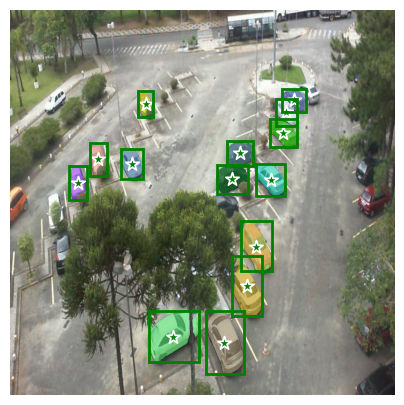

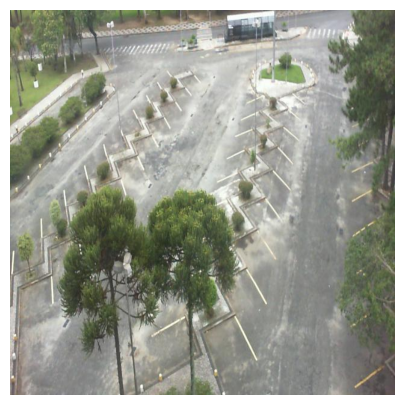

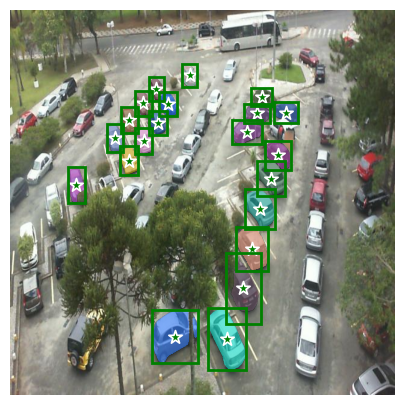

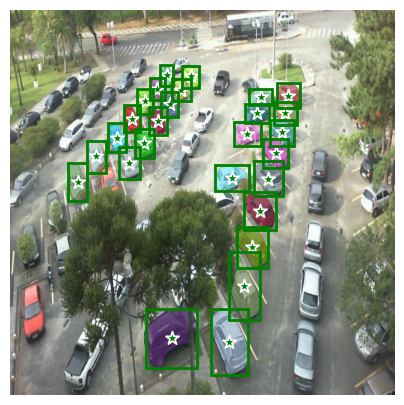

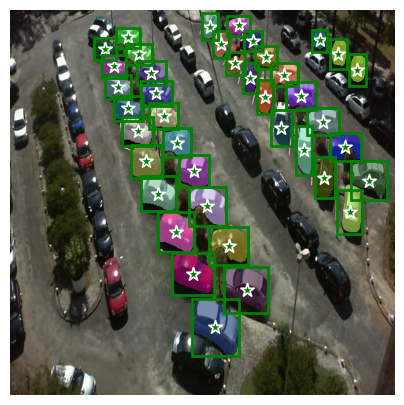

...

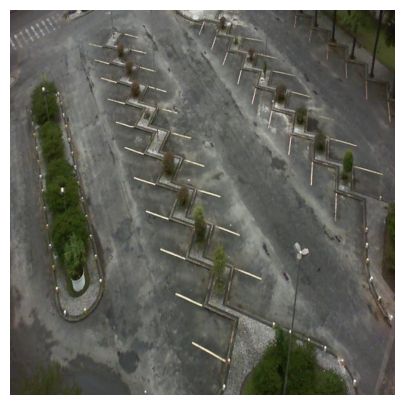

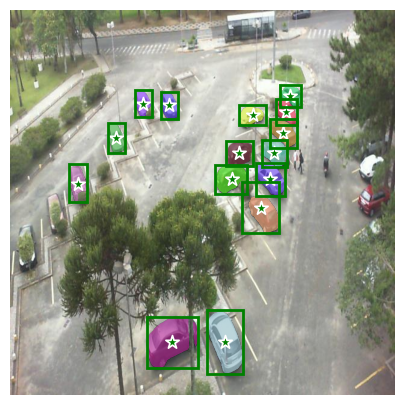

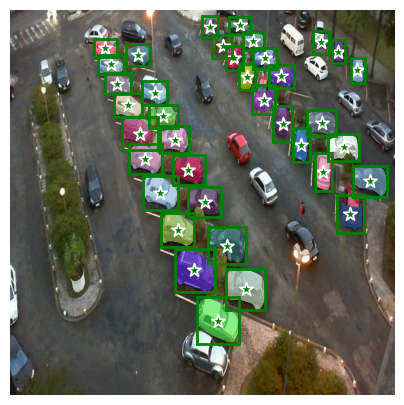

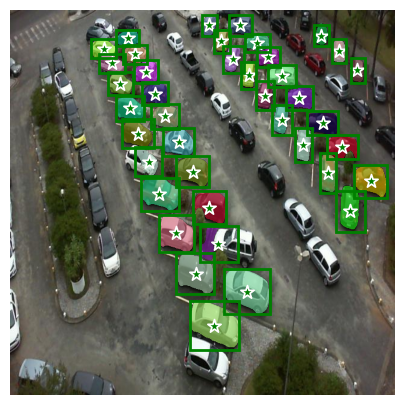

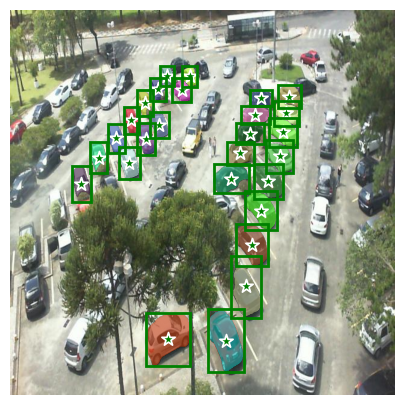

In [139]:
for label_name in os.listdir("new_labels"):
	label_path = "new_labels/" + label_name
	img_name = label_name.replace('.txt', '.jpg')
	img_path = "images/" + img_name

	image = Image.open(img_path)
	image = np.array(image.convert("RGB"))
	height, width, _ = image.shape

	predictor.set_image(image)

	# Bx1x2 where B corresponds to number of objects 
	input_points = np.empty((0, 1, 2))
	input_labels = np.empty((0, 1))
	input_boxes = np.empty((0, 4))

	with open(label_path, 'r') as f:
			labels = f.read().strip().split('\n')

	for line in labels:
		parts = line.strip().split()

		class_id = int(parts[0])

		if class_id == 1:
			x_center = float(parts[1])
			y_center = float(parts[2])
			box_width = float(parts[3])
			box_height = float(parts[4])

			# Координаты центра
			x_center_px = int(x_center * width)
			y_center_px = int(y_center * height)

			# Добавляем точку с дополнительным измерением (1, 1, 2)
			point = np.array([[[x_center_px, y_center_px]]])  # Создаем 3-мерный массив
			input_points = np.vstack([input_points, point])
			input_labels = np.vstack([input_labels, [[1]]])

			x1 = int((x_center - box_width / 2) * width)
			y1 = int((y_center - box_height / 2) * height)
			x2 = int((x_center + box_width / 2) * width)
			y2 = int((y_center + box_height / 2) * height)

			input_boxes = np.vstack([input_boxes, [x1, y1, x2, y2]])

	plt.figure(figsize=(5,5))
	plt.imshow(image)
	if len(input_points) != 0:
		masks, scores, logits = predictor.predict(
			point_coords=input_points,
			point_labels=input_labels,
			box=input_boxes,
			multimask_output=False,
		)
		for mask in masks:
			show_mask(mask, plt.gca(), random_color=True, borders=False)
		show_points(input_points, input_labels, plt.gca())
		for box in input_boxes:
				show_box(box, plt.gca())
	plt.axis('off')